In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt 
from sklearn.preprocessing import LabelEncoder
import seaborn as sns
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
import scipy.stats as stats
%matplotlib inline

In [2]:
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

In [3]:
train_X = pd.read_csv("train_X.csv")
train_y = pd.read_csv("train_y.csv")
test_X = pd.read_csv("test_X.csv")

In [4]:
merged_data = pd.merge(train_X, train_y, on='Id')

In [5]:
merged_data.head()

,Material,D1,D2,D3,D4,D5,D6,D7,D8,D9,D10,D11,D12,D13,D14,D15,D16,D17,D18,D19,D20,D21,D22,D23,D24,D25,D26,D27,D28,D29,D30,D31,D32,D33,D34,D35,D36,D37,D38,D39,D40,D41,D42,D43,D44,D45,D46,D47,D48,D49,D50,D51,D52,D53,D54,D55,D56,D57,D58,D59,D60,D61,D62,D63,D64,D65,D66,D67,D68,D69,D70,D71,D72,D73,D74,D75,D76,D77,D78,D79,D80,D81,D82,D83,D84,D85,D86,D87,D88,D89,D90,D91,D92,D93,D94,D95,D96,D97,D98,D99,D100,D101,D102,D103,D104,D105,D106,D107,D108,D109,D110,D111,D112,D113,D114,D115,D116,D117,D118,D119,D120,D121,D122,D123,D124,D125,D126,D127,D128,D129,D130,D131,D132,Id,Egap
0,O4V1Y1,8,39,31,15.6667,10.22220,8,12,87,75,67.6667,25.7778,87,15.9994,88.9059,72.9065,33.9742,23.96630,15.9994,54.8,2183.00,2128.20,700.200,860.533,54.8,3,16,13,12.0000,5.33333,16,2,5,3,2.83333,1.111110,2,66,190,124,101.167,46.8889,66,1.22,3.44,2.22,2.76833,0.895556,3.44,2,2,0,2.00000,0.000000,2,0,4,4,2.66667,1.77778,4,0,3,3,0.666667,0.888889,0,0,0,0,0.0,0.0,0,3,6,3,5.33333,0.888889,6,0,0,0,0.000000,0.000000,0,0,2,2,1.333330,0.888889,2,0,9,9,2.66667,3.55556,0,0,0,0,0.0,0.0,0,2,9,7,4.000,2.666670,2,9.1050,32.3650,23.26000,13.6325,6.24417,9.1050,0.0,0.000,0.000,0.00000,0.000000,0.00,0,0.0,0.0,0.0,0.0,0.0,12,229,217,78.500,88.6667,12,8683,2.8121
1,Al1Ba2Cu2F11,9,56,47,17.6250,12.43750,9,9,93,84,77.6250,21.1406,93,18.9984,137.3270,118.3290,39.8569,30.28980,18.9984,53.5,1357.77,1304.27,389.844,462.474,53.5,2,17,15,14.1250,3.95312,17,2,6,4,2.81250,1.117190,2,57,215,158,90.125,45.5469,57,0.89,3.98,3.09,3.18562,1.092270,3.98,1,2,1,1.87500,0.218750,2,0,5,5,3.50000,2.06250,5,0,10,10,1.250000,2.187500,0,0,0,0,0.0,0.0,0,2,11,9,6.62500,1.609380,7,0,1,1,0.125000,0.218750,0,0,5,5,1.000000,0.500000,1,0,0,0,0.00000,0.00000,0,0,0,0,0.0,0.0,0,0,5,5,1.125,0.484375,1,9.7075,63.5900,53.88250,17.0364,11.63840,9.7075,0.0,1.970,1.970,1.35437,0.846484,1.97,0,0.0,0.0,0.0,0.0,0.0,15,229,214,81.125,90.9219,15,8788,2.5128
2,Li2O2Pd1,3,46,43,13.6000,12.96000,3,1,87,86,47.6000,37.2800,1,6.9410,106.4200,99.4790,30.4602,30.38390,6.9410,54.8,1828.05,1773.25,569.006,503.618,54.8,1,16,15,8.8000,6.24000,1,2,5,3,2.60000,0.960000,2,66,139,73,105.400,31.5200,66,0.98,3.44,2.46,2.20800,0.985600,0.98,0,2,2,1.20000,0.640000,1,0,4,4,1.60000,1.92000,0,0,10,10,2.000000,3.200000,0,0,0,0,0.0,0.0,0,1,10,9,4.80000,3.040000,1,0,1,1,0.400000,0.480000,0,0,2,2,0.800000,0.960000,0,0,0,0,0.00000,0.00000,0,0,0,0,0.0,0.0,0,0,2,2,1.200,0.640000,1,9.1050,16.5933,7.48833,13.1613,3.24507,9.1050,0.0,0.000,0.000,0.00000,0.000000,0.00,0,0.0,0.0,0.0,0.0,0.0,12,229,217,141.400,103.5200,12,5144,1.9510
3,Br2Cl2Cu1Rb2,17,37,20,29.5714,7.34694,17,4,95,91,64.2857,34.5306,4,35.4530,85.4678,50.0148,66.4565,18.54790,35.4530,171.6,1357.77,1186.17,408.213,271.302,171.6,1,17,16,11.5714,6.20408,1,3,5,2,4.00000,0.571429,3,102,220,118,145.143,42.7755,102,0.82,3.16,2.34,2.25429,0.920816,0.82,1,2,1,1.57143,0.489796,1,0,5,5,2.85714,2.44898,0,0,10,10,4.285710,4.897960,0,0,0,0,0.0,0.0,0,1,17,16,8.71429,5.387760,1,0,1,1,0.428571,0.489796,0,0,1,1,0.571429,0.489796,0,0,0,0,0.00000,0.00000,0,0,0,0,0.0,0.0,0,1,1,0,1.000,0.000000,1,11.0700,90.7225,79.65250,42.9243,27.31330,24.4975,0.0,2.493,2.493,1.12857,0.967347,0.00,0,0.0,0.0,0.0,0.0,0.0,64,229,165,134.143,80.1633,64,9593,1.0099
4,Al1K1O2,8,19,11,12.0000,4.00000,8,3,87,84,62.5000,29.7500,87,15.9994,39.0983,23.0989,24.5197,8.52026,15.9994,54.8,933.47,878.67,344.900,294.285,54.8,1,16,15,11.5000,5.25000,16,2,4,2,2.75000,0.750000,2,66,203,137,114.000,48.0000,66,0.82,3.44,2.62,2.32750,1.112500,3.44,1,2,1,1.75000,0.375000,2,0,4,4,2.25000,1.75000,4,0,0,0,0.000000,0.000000,0,0,0,0,0.0,0.0,0,1,6,5,4.00000,2.000000,6,0,1,1,0.250000,0.375000,0,0,5,5,2.250000,1.375000,2,0,0,0,0.00000,0.00000,0,0,0,0,0.0,0.0,0,1,5,4,2.500,1.250000,2,9.1050,73.1067,64.00170,26.9492,23.07880,9.1050,0.0,0.000,0.000,0.00000,0.000000,0.00,0,0.0,0.0,0.0,0.0,0.0,12,229,217,119.500,107.5000,12,2027,2.9344


In [6]:
Id = merged_data.Id
merged_data = merged_data.drop("Id", axis = 1)

In [7]:
merged_data = merged_data.drop_duplicates()

In [8]:
merged_data = merged_data.drop("Material", axis = 1)

In [26]:
y = merged_data.Egap
X = merged_data.drop("Egap", axis = 1)

In [10]:
s = StandardScaler()
X = s.fit_transform(X)

In [27]:
import numpy as np
from sklearn.model_selection import train_test_split, RandomizedSearchCV
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor, ExtraTreesRegressor
from sklearn.linear_model import ElasticNet, Lasso
from sklearn.svm import SVR
from sklearn.ensemble import StackingRegressor
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.feature_selection import SelectFromModel
from sklearn.neural_network import MLPRegressor

# Feature engineering
def engineer_features(X):
    X_new = X.copy()
    X_new['D1_D2_ratio'] = X['D1'] / X['D2']
    X_new['D3_D4_ratio'] = X['D3'] / X['D4']
    X_new['D5_D6_ratio'] = X['D5'] / X['D6']
    return X_new

X = engineer_features(X)

# Split the data
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Scale the features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Feature selection
selector = SelectFromModel(estimator=RandomForestRegressor(n_estimators=100, random_state=42), threshold='median')
X_train_selected = selector.fit_transform(X_train_scaled, y_train)
X_test_selected = selector.transform(X_test_scaled)

# Define base models with hyperparameter search spaces
rf_params = {
    'n_estimators': [200, 300, 400],
    'max_depth': [10, 20, 30, None],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4]
}

gb_params = {
    'n_estimators': [100, 200, 300],
    'learning_rate': [0.01, 0.1, 0.2],
    'max_depth': [3, 5, 7],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4]
}

et_params = {
    'n_estimators': [100, 200, 300],
    'max_depth': [10, 20, 30, None],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4]
}

svr_params = {
    'C': [0.1, 1, 10],
    'epsilon': [0.01, 0.1, 0.2],
    'kernel': ['rbf', 'poly']
}

en_params = {
    'alpha': [0.1, 0.5, 1.0],
    'l1_ratio': [0.1, 0.5, 0.9]
}

lasso_params = {
    'alpha': [0.1, 0.5, 1.0]
}

mlp_params = {
    'hidden_layer_sizes': [(50,), (100,), (50, 50), (100, 50)],
    'alpha': [0.0001, 0.001, 0.01],
    'learning_rate': ['constant', 'adaptive']
}

# Perform RandomizedSearchCV for each base model
base_models = []
for name, model, params in [
    ('rf', RandomForestRegressor(random_state=42), rf_params),
    ('gb', GradientBoostingRegressor(random_state=42), gb_params),
    ('et', ExtraTreesRegressor(random_state=42), et_params),
    ('svr', SVR(), svr_params),
    ('en', ElasticNet(random_state=42), en_params),
    ('lasso', Lasso(random_state=42), lasso_params),
    ('mlp', MLPRegressor(random_state=42, max_iter=1000), mlp_params)
]:
    random_search = RandomizedSearchCV(model, params, n_iter=20, cv=5, n_jobs=-1, random_state=42)
    random_search.fit(X_train_selected, y_train)
    base_models.append((name, random_search.best_estimator_))
    print(f"Best parameters for {name}: {random_search.best_params_}")

# Define the meta-model
meta_model = GradientBoostingRegressor(random_state=42)

# Create the StackingRegressor
stacking_regressor = StackingRegressor(
    estimators=base_models,
    final_estimator=meta_model,
    cv=5
)

# Fit the StackingRegressor
stacking_regressor.fit(X_train_selected, y_train)

# Make predictions on the test set
y_pred = stacking_regressor.predict(X_test_selected)

# Calculate RMSE and R2 score
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
r2 = r2_score(y_test, y_pred)

print(f"Test RMSE: {rmse:.4f}")
print(f"Test R2 Score: {r2:.4f}")


Best parameters for rf: {'n_estimators': 400, 'min_samples_split': 2, 'min_samples_leaf': 1, 'max_depth': 30}
Best parameters for gb: {'n_estimators': 300, 'min_samples_split': 10, 'min_samples_leaf': 4, 'max_depth': 7, 'learning_rate': 0.1}
Best parameters for et: {'n_estimators': 300, 'min_samples_split': 5, 'min_samples_leaf': 2, 'max_depth': None}


C:\Users\Lenovo\anaconda3\Lib\site-packages\sklearn\model_selection\_search.py:318: UserWarning: The total space of parameters 18 is smaller than n_iter=20. Running 18 iterations. For exhaustive searches, use GridSearchCV.
  warnings.warn(


Best parameters for svr: {'kernel': 'rbf', 'epsilon': 0.2, 'C': 10}


C:\Users\Lenovo\anaconda3\Lib\site-packages\sklearn\model_selection\_search.py:318: UserWarning: The total space of parameters 9 is smaller than n_iter=20. Running 9 iterations. For exhaustive searches, use GridSearchCV.
  warnings.warn(


Best parameters for en: {'l1_ratio': 0.1, 'alpha': 0.1}


C:\Users\Lenovo\anaconda3\Lib\site-packages\sklearn\model_selection\_search.py:318: UserWarning: The total space of parameters 3 is smaller than n_iter=20. Running 3 iterations. For exhaustive searches, use GridSearchCV.
  warnings.warn(


Best parameters for lasso: {'alpha': 0.1}
Best parameters for mlp: {'learning_rate': 'constant', 'hidden_layer_sizes': (100,), 'alpha': 0.01}
Test RMSE: 0.8039
Test R2 Score: 0.7403


In [23]:
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.linear_model import ElasticNet
from sklearn.svm import SVR
from sklearn.ensemble import StackingRegressor
from sklearn.metrics import mean_squared_error, r2_score


# Split the data
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Scale the features

# Define base models
base_models = [
    ('rf', RandomForestRegressor(max_depth=20, max_features="sqrt", min_samples_leaf=1, min_samples_split=2,n_estimators = 300, random_state=42)),
    ('gb', GradientBoostingRegressor(learning_rate=0.1,max_depth=7, min_samples_leaf=4, min_samples_split=10,n_estimators=200, random_state=42))
]

# Define the meta-model
meta_model = GradientBoostingRegressor(learning_rate=0.1,max_depth=7, min_samples_leaf=4, min_samples_split=10,n_estimators=200, random_state=42)

# Create the StackingRegressor
stacking_regressor = StackingRegressor(
    estimators=base_models,
    final_estimator=meta_model,
    cv=5
)

# Fit the StackingRegressor
stacking_regressor.fit(X_train_scaled, y_train)

# Make predictions on the test set
y_pred = stacking_regressor.predict(X_test_scaled)

# Calculate RMSE and R2 score
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
r2 = r2_score(y_test, y_pred)

print(f"Test RMSE: {rmse}")
print(f"Test R2 Score: {r2}")


Test RMSE: 0.8398836052723675
Test R2 Score: 0.7165064223753663


In [14]:
from sklearn.model_selection import train_test_split, GridSearchCV
param_grid = {
    'C': [0.1, 1, 10, 100],
    'epsilon': [0.01, 0.1, 0.5, 1],
    'kernel': ['rbf', 'linear']
}

# Create an SVR object
svr = SVR()

# Create GridSearchCV object
grid_search = GridSearchCV(estimator=svr, param_grid=param_grid, 
                           cv=5, n_jobs=-1, verbose=2, scoring='neg_mean_squared_error')

# Fit the GridSearchCV object to the data
grid_search.fit(X, y)

# Print the best parameters and score
print("Best parameters:", grid_search.best_params_)
print("Best negative MSE:", grid_search.best_score_)

# Get the best model
best_svr = grid_search.best_estimator_

# Make predictions using the best model
y_pred = best_svr.predict(X)

# Calculate RMSE
rmse = np.sqrt(mean_squared_error(y, y_pred))
print("RMSE:", rmse)


Fitting 5 folds for each of 32 candidates, totalling 160 fits
Best parameters: {'C': 10, 'epsilon': 0.5, 'kernel': 'rbf'}
Best negative MSE: -0.7300625696741061
RMSE: 0.7059588576532516


In [71]:
print(f"Test RMSE: {rmse}")
print(f"Test R2 Score: {r2}")


Test RMSE: 0.8075639900917757
Test R2 Score: 0.7379048965490909


In [66]:
param_grid = {
    'n_estimators': [100, 200, 300],
    'max_depth': [None, 10, 20],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'max_features': ['auto', 'sqrt']
}

# Create a RandomForestRegressor instance
rf = RandomForestRegressor(random_state=42)

# Set up GridSearchCV
grid_search = GridSearchCV(estimator=rf, param_grid=param_grid,
                           cv=5, n_jobs=-1, verbose=2,
                           scoring='neg_mean_squared_error')

# Fit the grid search to the training data
grid_search.fit(X_train, y_train)

# Get the best parameters and best score
best_params = grid_search.best_params_
best_score = np.sqrt(-grid_search.best_score_)

print("Best parameters:", best_params)
print("Best RMSE from CV:", best_score)

# Use the best model to make predictions on the test set
best_model = grid_search.best_estimator_
y_pred = best_model.predict(X_test)

# Calculate RMSE on the test set
test_rmse = np.sqrt(mean_squared_error(y_test, y_pred))
print("Test RMSE:", test_rmse)


Fitting 5 folds for each of 162 candidates, totalling 810 fits
Best parameters: {'max_depth': 20, 'max_features': 'sqrt', 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 300}
Best RMSE from CV: 0.8160111582916295
Test RMSE: 0.8246031301102423


In [69]:
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.metrics import mean_squared_error
import numpy as np

# Data is already prepared as X and y

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Define the parameter grid
param_grid = {
    'n_estimators': [100, 200, 300],
    'learning_rate': [0.01, 0.1, 0.2],
    'max_depth': [3, 5, 7],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4]
}

# Create a GradientBoostingRegressor instance
gb = GradientBoostingRegressor(random_state=42)

# Set up GridSearchCV
grid_search = GridSearchCV(estimator=gb, param_grid=param_grid,
                           cv=5, n_jobs=-1, verbose=2,
                           scoring='neg_mean_squared_error')

# Fit the grid search to the data
grid_search.fit(X_train, y_train)

# Get the best parameters and best score
best_params = grid_search.best_params_
best_score = np.sqrt(-grid_search.best_score_)

print("Best parameters:", best_params)
print("Best RMSE from CV:", best_score)

# Use the best model to make predictions on the test set
best_model = grid_search.best_estimator_
y_pred = best_model.predict(X_test)

# Calculate RMSE on the test set
test_rmse = np.sqrt(mean_squared_error(y_test, y_pred))
print("Test RMSE:", test_rmse)


Fitting 5 folds for each of 243 candidates, totalling 1215 fits
Best parameters: {'learning_rate': 0.1, 'max_depth': 7, 'min_samples_leaf': 4, 'min_samples_split': 10, 'n_estimators': 200}
Best RMSE from CV: 0.7884615907438258
Test RMSE: 0.8036705832529346


In [72]:
param_grid = {
    'alpha': [0.1, 0.5, 1.0, 2.0, 5.0],
    'l1_ratio': [0.1, 0.3, 0.5, 0.7, 0.9],
    'max_iter': [1000, 2000, 5000]
}

# Create an ElasticNet instance
elastic_net = ElasticNet(random_state=42)

# Set up GridSearchCV
grid_search = GridSearchCV(
    estimator=elastic_net,
    param_grid=param_grid,
    cv=5,
    n_jobs=-1,
    verbose=2,
    scoring='neg_mean_squared_error'
)

# Fit the grid search to the data
grid_search.fit(X_train_scaled, y_train)

# Get the best parameters and best score
best_params = grid_search.best_params_
best_score = np.sqrt(-grid_search.best_score_)

print("Best parameters:", best_params)
print("Best RMSE:", best_score)

# Use the best model to make predictions on the test set
best_model = grid_search.best_estimator_
y_pred = best_model.predict(X_test_scaled)

# Calculate RMSE and R2 score on the test set
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
r2 = r2_score(y_test, y_pred)

print("Test RMSE:", rmse)
print("Test R2 Score:", r2)


Fitting 5 folds for each of 75 candidates, totalling 375 fits
Best parameters: {'alpha': 0.1, 'l1_ratio': 0.1, 'max_iter': 1000}
Best RMSE: 1.1006912198895618
Test RMSE: 1.1143096778513446
Test R2 Score: 0.5009812984170443


In [62]:

# Use the best model to make predictions on the test set
y_pred = grid_search.predict(X_test_scaled)

# Calculate RMSE and R2 score on the test set
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
r2 = r2_score(y_test, y_pred)

print("Test RMSE:", rmse)
print("Test R2 Score:", r2)

Test RMSE: 0.8333608469491708
Test R2 Score: 0.7208926957784026


In [29]:
best_model = grid_search.best_estimator_

In [33]:
X_train_selected.shape

(7712, 68)

In [32]:
t.shape

(4132, 135)

In [30]:
Id = test_X.Id
t = test_X.drop(["Id", "Material"], axis = 1)
t = engineer_features(t)
t = scaler.transform(t)
y_pred = stacking_regressor.predict(t)
sols = pd.DataFrame({"Id":Id, "Egap": y_pred})
sols.to_csv("Solution.csv", index = False)

ValueError: X has 135 features, but RandomForestRegressor is expecting 68 features as input.

In [5]:
train_X.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9640 entries, 0 to 9639
Columns: 134 entries, Material to Id
dtypes: float64(67), int64(66), object(1)
memory usage: 9.9+ MB


In [7]:
for i in train_X.columns:
    if train_X[i].isna().sum()!=0:
        print(i,train_X[i].isna().sum())
train_X.describe()

,D1,D2,D3,D4,D5,D6,D7,D8,D9,D10,D11,D12,D13,D14,D15,D16,D17,D18,D19,D20,D21,D22,D23,D24,D25,D26,D27,D28,D29,D30,D31,D32,D33,D34,D35,D36,D37,D38,D39,D40,D41,D42,D43,D44,D45,D46,D47,D48,D49,D50,D51,D52,D53,D54,D55,D56,D57,D58,D59,D60,D61,D62,D63,D64,D65,D66,D67,D68,D69,D70,D71,D72,D73,D74,D75,D76,D77,D78,D79,D80,D81,D82,D83,D84,D85,D86,D87,D88,D89,D90,D91,D92,D93,D94,D95,D96,D97,D98,D99,D100,D101,D102,D103,D104,D105,D106,D107,D108,D109,D110,D111,D112,D113,D114,D115,D116,D117,D118,D119,D120,D121,D122,D123,D124,D125,D126,D127,D128,D129,D130,D131,D132,Id
count,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.0,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.0,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000,9640.000000
mean,10.982365,49.404668,38.422303,22.723951,12.274783,13.968672,30.895124,89.397303,58.502178,71.934448,19.650843,79.374689,23.219330,118.884081,95.664840,51.924858,30.464861,30.272230,167.217701,1761.456898,1594.239197,600.486094,505.707339,219.694082,4.368568,16.077801,11.709232,12.102123,4.296586,13.409544,2.329668,5.037656,2.707988,3.206569,0.927640,2.507469,76.487344,173.651867,97.164523,108.216243,33.598078,82.390145,1.308243,3.183366,1.875123,2.511597,0.702441,2.846951,1.436515,1.998340,0.561826,1.830382,0.200425,1.853216,0.235581,4.125104,3.889523,2.599490,1.554678,3.233817,0.417220,6.503631,6.086411,2.308907,2.020104,1.301349,0.002178,3.612967,3.610788,0.793610,1.129257,0.053320,3.289004,13.536515,10.247510,7.532389,3.084474,6.605083,0.001660,0.542427,0.540768,0.164532,0.194486,0.076867,0.195954,3.001660,2.805705,1.531639,0.921562,1.500311,0.000311,2.546888,2.546577,0.501601,0.745441,0.010373,0.0,0.858402,0.858402,0.174488,0.261773,0.006224,0.939834,5.255602,4.315768,2.372260,1.251894,1.694917,11.733542,44.362985,32.629447,21.771023,10.171960,15.619156,0.063598,2.413483,2.349884,1.148350,0.875764,1.177543,0.0,0.132355,0.132355,0.022217,0.034221,0.001197,40.426660,215.416286,174.989627,109.378317,70.288082,56.947095,6919.421058
std,9.850343,22.027500,21.335998,12.407125,7.633257,12.784416,29.980515,4.076002,29.718833,12.670021,11.760649,24.461628,23.067494,58.281521,56.278177,30.818857,19.990002,31.155121,263.778833,987.087265,1018.544788,393.878890,343.779233,391.356911,4.617021,1.206273,4.654914,2.689233,2.081195,5.533355,0.894492,1.084142,1.210537,0.866428,0.451151,1.000646,28.377607,37.857281,44.448974,26.467764,15.851632,32.794632,0.496239,0.518088,0.714419,0.444358,0.285301,0.855895,0.523654,0.040708,0.523853,0.205311,0.203156,0.356828,0.733783,0.808011,1.038493,0.842817,0.515604,1.751882,1.870536,4.195971

From this it can be seen that there is no null values

In [9]:
string_columns = train_X.select_dtypes(include='object').columns
string_columns

Index(['Material'], dtype='object')

In [16]:
a = set()
for i in train_X['Material']:
    if train_X['Material'].value_counts()[i] > 1:
        a.add(i)
len(a)


731

In [17]:
a

{'Ag1Al1O2',
 'Ag1Bi1Se2',
 'Ag1Bi1Te2',
 'Ag1Br1',
 'Ag1C1N1O1',
 'Ag1Cl1',
 'Ag1Cl1O4',
 'Ag1Co1O2',
 'Ag1Cu1O4P1',
 'Ag1Cu1S1',
 'Ag1Dy1Se2',
 'Ag1Hg1I1S1',
 'Ag1I1',
 'Ag1In1S2',
 'Ag1K1O1',
 'Ag1N1O3',
 'Ag1N3',
 'Ag1O1Rb1',
 'Ag1O2Sc1',
 'Ag1O3Sb1',
 'Ag1O3Ta1',
 'Ag1O3V1',
 'Ag1Pb1S3Sb1',
 'Ag1S2Sb1',
 'Ag2C1O3',
 'Ag2O6Te2',
 'Ag2S1',
 'Ag3As1S3',
 'Ag3As1Se3',
 'Ag3C6K2N6Na1',
 'Ag3O4V1',
 'Ag4Mn1S6Sb2',
 'Al1As1O4',
 'Al1B1Ba1F2O3',
 'Al1Ba1F5',
 'Al1Ca1F5',
 'Al1Ca1H5',
 'Al1Ca1O5Ta1',
 'Al1Ce1O3',
 'Al1Cl4Cu1',
 'Al1F3',
 'Al1F4K1',
 'Al1F4Rb1',
 'Al1F4Tl1',
 'Al1F5Mn1',
 'Al1F6K2Li1',
 'Al1F6K2Na1',
 'Al1F6Li1Sr1',
 'Al1F7Mg1Na2',
 'Al1H1O2',
 'Al1H3',
 'Al1H3O3',
 'Al1H4K1',
 'Al1H6K2Li1',
 'Al1H6K3',
 'Al1K1O2',
 'Al1K1O4Si1',
 'Al1La1O3',
 'Al1Li1O2',
 'Al1Li1O4Si1',
 'Al1Li5O4',
 'Al1N1',
 'Al1Na1O4Si1',
 'Al1O4P1',
 'Al1P1',
 'Al2Ca1O4',
 'Al2Ca3N4',
 'Al2H4O9Si2',
 'Al2Hg1Se4',
 'Al2O12W3',
 'Al2O3',
 'Al2O5Si1',
 'Al2Se4Zn1',
 'Al5C3N1',
 'Al5Lu3O12',
 'As1Ca1F1Mg1O

In [19]:
b = list(a)
b[0]

'Al1Na1O4Si1'

In [31]:
found_rows = train_X[train_X['Material'].isin(b[0:3])]

# Display the found rows
print(found_rows)

         Material  D1  D2  D3    D4        D5  D6  D7  D8  D9      D10  \
769   Al1Na1O4Si1   8  14   6  10.0   2.28571   8   2  87  85  71.5714   
3135     Al1Ce1O3   8  58  50  19.0  15.60000   8  15  87  72  69.8000   
3367     Cu1La1S2  16  57  41  29.5  13.75000  16  13  88  75  63.2500   
5266     Cu1La1S2  16  57  41  29.5  13.75000  16  13  88  75  63.2500   
6562  Al1Na1O4Si1   8  14   6  10.0   2.28571   8   2  87  85  71.5714   
9615     Al1Ce1O3   8  58  50  19.0  15.60000   8  15  87  72  69.8000   

          D11  D12      D13       D14       D15      D16       D17      D18  \
769   19.8776   87  15.9994   28.0855   12.0861  20.2935   4.90753  15.9994   
3135  21.9200   87  15.9994  140.1160  124.1170  43.0191  38.83870  15.9994   
3367  25.1250   88  32.0650  138.9050  106.8400  66.6454  36.13010  32.0650   
5266  25.1250   88  32.0650  138.9050  106.8400  66.6454  36.13010  32.0650   
6562  19.8776   87  15.9994   28.0855   12.0861  20.2935   4.90753  15.9994   
9615  2

In [25]:
Id = train_X.Id
train_X = train_X.drop("Id", axis = 1)

In [30]:
train_X.drop_duplicates()

,Material,D1,D2,D3,D4,D5,D6,D7,D8,D9,D10,D11,D12,D13,D14,D15,D16,D17,D18,D19,D20,D21,D22,D23,D24,D25,D26,D27,D28,D29,D30,D31,D32,D33,D34,D35,D36,D37,D38,D39,D40,D41,D42,D43,D44,D45,D46,D47,D48,D49,D50,D51,D52,D53,D54,D55,D56,D57,D58,D59,D60,D61,D62,D63,D64,D65,D66,D67,D68,D69,D70,D71,D72,D73,D74,D75,D76,D77,D78,D79,D80,D81,D82,D83,D84,D85,D86,D87,D88,D89,D90,D91,D92,D93,D94,D95,D96,D97,D98,D99,D100,D101,D102,D103,D104,D105,D106,D107,D108,D109,D110,D111,D112,D113,D114,D115,D116,D117,D118,D119,D120,D121,D122,D123,D124,D125,D126,D127,D128,D129,D130,D131,D132
0,O4V1Y1,8,39,31,15.66670,10.222200,8,12,87,75,67.6667,25.777800,87,15.99940,88.90590,72.90650,33.97420,2.396630e+01,15.99940,54.80,2183.00,2128.20,700.2000,8.605330e+02,54.80,3,16,13,12.00000,5.333330,16,2,5,3,2.83333,1.111110,2,66,190,124,101.1670,46.888900,66,1.220,3.44,2.220,2.76833,8.955560e-01,3.440,2,2,0,2.00000,0.000000,2,0,4,4,2.666670,1.777780,4,0,3,3,0.666667,0.888889,0,0,0,0,0.000000,0.000000,0,3,6,3,5.33333,0.888889,6,0,0,0,0.000000,0.000000,0,0,2,2,1.333330,0.888889,2,0,9,9,2.666670,3.555560,0,0,0,0,0.000000,0.000000,0,2,9,7,4.000000,2.666670,2,9.1050,32.3650,23.260000,13.63250,6.244170,9.1050,0.000,0.000,0.000,0.000000,0.000000e+00,0.000,0,0.000000,0.000000,0.000000e+00,0.000000e+00,0.000000,12,229,217,78.50000,88.666700,12
1,Al1Ba2Cu2F11,9,56,47,17.62500,12.437500,9,9,93,84,77.6250,21.140600,93,18.99840,137.32700,118.32900,39.85690,3.028980e+01,18.99840,53.50,1357.77,1304.27,389.8440,4.624740e+02,53.50,2,17,15,14.12500,3.953120,17,2,6,4,2.81250,1.117190,2,57,215,158,90.1250,45.546900,57,0.890,3.98,3.090,3.18562,1.092270e+00,3.980,1,2,1,1.87500,0.218750,2,0,5,5,3.500000,2.062500,5,0,10,10,1.250000,2.187500,0,0,0,0,0.000000,0.000000,0,2,11,9,6.62500,1.609380,7,0,1,1,0.125000,0.218750,0,0,5,5,1.000000,0.500000,1,0,0,0,0.000000,0.000000,0,0,0,0,0.000000,0.000000,0,0,5,5,1.125000,0.484375,1,9.7075,63.5900,53.882500,17.03640,11.638400,9.7075,0.000,1.970,1.970,1.354370,8.464840e-01,1.970,0,0.000000,0.000000,0.000000e+00,0.000000e+00,0.000000,15,229,214,81.12500,90.921900,15
2,Li2O2Pd1,3,46,43,13.60000,12.960000,3,1,87,86,47.6000,37.280000,1,6.94100,106.42000,99.47900,30.46020,3.038390e+01,6.94100,54.80,1828.05,1773.25,569.0060,5.036180e+02,54.80,1,16,15,8.80000,6.240000,1,2,5,3,2.60000,0.960000,2,66,139,73,105.4000,31.520000,66,0.980,3.44,2.460,2.20800,9.856000e-01,0.980,0,2,2,1.20000,0.640000,1,0,4,4,1.600000,1.920000,0,0,10,10,2.000000,3.200000,0,0,0,0,0.000000,0.000000,0,1,10,9,4.80000,3.040000,1,0,1,1,0.400000,0.480000,0,0,2,2,0.800000,0.960000,0,0,0,0,0.000000,0.000000,0,0,0,0,0.000000,0.000000,0,0,2,2,1.200000,0.640000,1,9.1050,16.5933,7.488330,13.16130,3.245070,9.1050,0.000,0.000,0.000,0.000000,0.000000e+00,0.000,0,0.000000,0.000000,0.000000e+00,0.000000e+00,0.000000,12,229,217,141.40000,103.520000,12
3,Br2Cl2Cu1Rb2,17,37,20,29.57140,7.346940,17,4,95,91,64.2857,34.530600,4,35.45300,85.46780,50.01480,66.45650,1.854790e+01,35.45300,171.60,1357.77,1186.17,408.2130,2.713020e+02,171.60,1,17,16,11.57140,6.204080,1,3,5,2,4.00000,0.571429,3,102,220,118,145.1430,42.775500,102,0.820,3.16,2.340,2.25429,9.208160e-01,0.820,1,2,1,1.57143,0.489796,1,0,5,5,2.857140,2.448980,0,0,10,10,4.285710,4.897960,0,0,0,0,0.000000,0.000000,0,1,17,16,8.71429,5.387760,1,0,1,1,0.428571,0.489796,0,0,1,1,0.571429,0.489796,0,0,0,0,0.000000,0.000000,0,0,0,0,0.000000,0.000000,0,1,1,0,1.000000,0.000000,1,11.0700,90.7225,79.652500,42.92430,27.313300,24.4975,0.000,2.493,2.493,1.128570,9.673470e-01,0.000,0,0.000000,0.000000,0.000000e+00,0.000000e+00,0.000000,64,229,165,134.14300,80.163300,64
4,Al1K1O2,8,19,11,12.00000,4.000000,8,3,87,84,62.5000,29.750000,87,15.99940,39.09830,23.09890,24.51970,8.520260e+00,15.99940,54.80,933.47,878.67,344.9000,2.942850e+02,54.80,1,16,15,11.50000,5.250000,16,2,4,2,2.75000,0.750000,2,66,203,137,114.0000,48.000000,66,0.820,3.44,2.620,2.32750,1.112500e+00,3.440,1,2,1,1.75000,0.375000,2,0,4,4,2.250000,1.750000,4,0,0,0,0.000000,0.000000,0,0,0,0,0.000000,0.000000,0,1,6,5,4.0

In [27]:
a = set()
for i in train_X_cleaned['Material']:
    if train_X_cleaned['Material'].value_counts()[i] > 1:
        a.add(i)
len(a)


0

In [28]:
train_X_cleaned.to_csv("train_X_cleaned.csv", index = False)

In [36]:
import pandas as pd
import numpy as np
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt
from sklearn.cluster import DBSCAN
import seaborn as sns
from scipy.spatial.distance import pdist, squareform, cdist
from scipy.cluster.hierarchy import dendrogram
from sklearn.cluster import AgglomerativeClustering
import warnings
warnings.filterwarnings('ignore')

In [37]:
inertias = []
distortions = []
k_range = range(1, 50)
for k in k_range:
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(X_scaled)
    inertias.append(kmeans.inertia_)
    distortions.append(sum(np.min(cdist(X_scaled, kmeans.cluster_centers_, 'euclidean'), axis=1)) / X_scaled.shape[0])

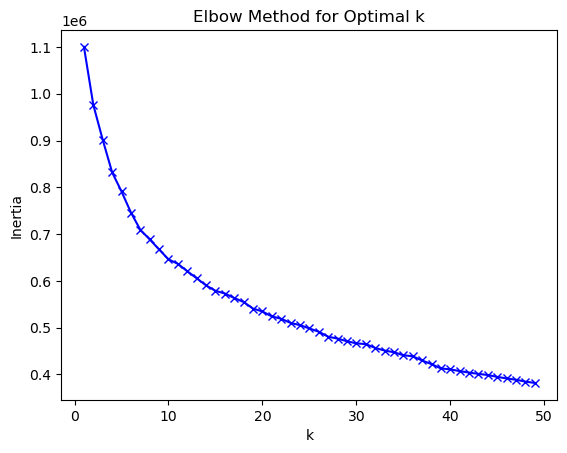

In [38]:
plt.plot(k_range, inertias, 'bx-')
plt.xlabel('k')
plt.ylabel('Inertia')
plt.title('Elbow Method for Optimal k')
plt.show()

In [39]:
# Perform K-means clustering
n_clusters = 10
kmeans = KMeans(n_clusters=n_clusters, random_state=42)
cluster_labels = kmeans.fit_predict(X_scaled)

In [40]:
# Dimensionality reduction
pca = PCA(n_components=4)
X_pca = pca.fit_transform(X_scaled)

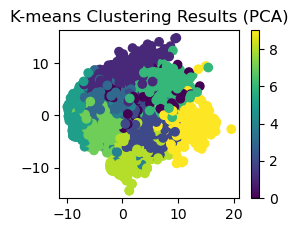

In [41]:
# 1. K-means clustering results (PCA)
plt.subplot(2, 2, 1)
scatter = plt.scatter(X_pca[:, 0], X_pca[:, 1], c=cluster_labels, cmap='viridis')
plt.title('K-means Clustering Results (PCA)')
plt.colorbar(scatter)
plt.show()

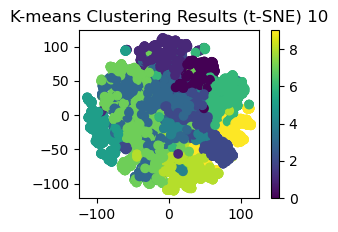

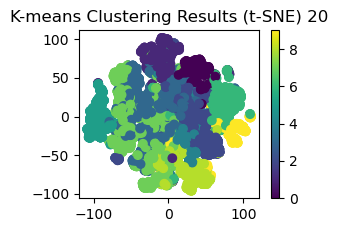

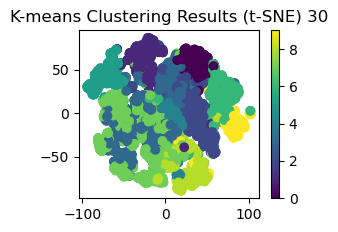

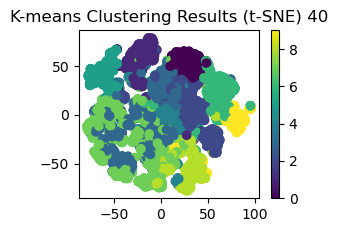

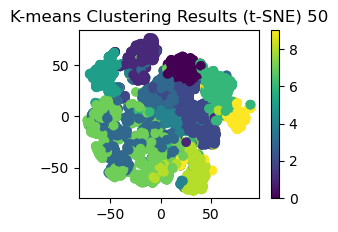

In [42]:
# K-means clustering results (t-SNE)
for i in range(10, 51, 10):
    tsne = TSNE(perplexity=i, random_state=42)
    X_tsne = tsne.fit_transform(X_scaled)
    plt.subplot(2, 2, 1)
    scatter = plt.scatter(X_tsne[:, 0], X_tsne[:, 1], c=cluster_labels, cmap='viridis')
    plt.title('K-means Clustering Results (t-SNE) '+str(i))
    plt.colorbar(scatter)
    plt.show()